### Averon Notebook for predicting actionable cancer vulnerabilities enabled by mutant-directed protein-protein interactions.<br>
Authors: Hongyue (Nicole) Chen and Andrey A. Ivanov<br>
Ivanov Lab, Department of Pharmacology and Chemical Biology,<br>
Emory University School of Medicine,<br>
Emory University<br>
Atlanta, GA 30322, USA<br>

### Preparation

In [ ]:
pip install tabulate

In [ ]:
pip install ipycytoscape

In [ ]:
pip install py4cytoscape --upgrade

In [ ]:
pip install --force-reinstall -v "pandas==2.0.1" --user

In [ ]:
pip install scikit_posthocs

In [ ]:
pip install numpy --upgrade numpy

In [ ]:
pip install seaborn --upgrade seaborn

In [ ]:
pip install lifelines

In [ ]:
pip install Jinja2==3.0.0

In [ ]:
pip install --upgrade --user matplotlib

In [ ]:
pip install pillow --upgrade

In [ ]:
pip install pygtop

In [ ]:
pip install --upgrade ipywidgets

In [113]:
#%reset
import warnings
warnings.filterwarnings('ignore')
import sys, os, importlib,ipycytoscape,requests,pygtop,lifelines
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
import tkinter;
import seaborn as sns
sys.path.insert(0, os.path.abspath('../src'))
import averon as av
pd.set_option("display.max_rows", None)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
%matplotlib inline
pd.set_option('display.max_columns', None) #unlimit number of columns to show in dataframes

### Define the folders
<div style="color:red">
Make sure the parent_folder is set to the root Averon folder
</div>

In [114]:
#Define the folders
#Make sure the parent_folder is set to the root Averon folder
parent_folder = "/AVERON/"
os.chdir(parent_folder)

In [115]:
#Set output folders:
out_folder = parent_folder+"output"+"/" #save data files, e.g. tbles, here
fig_folder = out_folder+"Figures/" #save pictures here
tbl_folder = out_folder+"Tables/" #save tables here
net_folder = out_folder+"Networks/" #save netowrks here

#Folder with all input files:
data_folder = parent_folder+"input"+"/"

#pathway folder.
pathway_folder = data_folder+"pathway_genesets/MSigDB/"

#Set input files
genomics_clinical_folder = data_folder+"genomics_and_clinical/"
#HGNC gene annotations from https://www.genenames.org/
hgnc_f = genomics_clinical_folder + "hgnc5.txt"

#Mutation data from https://gdc.cancer.gov/about-data/publications/pancanatlas
mut_f = genomics_clinical_folder +"mc3.v0.2.8.PUBLIC.maf" 

#mRNA expression data from https://gdc.cancer.gov/about-data/publications/pancanatlas
exp_f = genomics_clinical_folder + "EBPlusPlusAdjustPANCAN_IlluminaHiSeq_RNASeqV2.geneExp.refined.tsv" 
    
#CNV data from https://gdc.cancer.gov/about-data/publications/pancan-aneuploidy
cnv_f = genomics_clinical_folder + "all_thresholded.by_genes_whitelisted.refined.tsv"

#Clinical data from https://gdc.cancer.gov/about-data/publications/pancanatlas
clinical_f = genomics_clinical_folder + "TCGA-CDR-SupplementalTableS1.tsv"

#Clinical with Follow-up from https://gdc.cancer.gov/about-data/publications/pancanatlas
# used to get bcr_patient_uuid
uuid_f = genomics_clinical_folder + "clinical_PANCAN_patient_with_followup.tsv"


In [116]:
#Get TCGA Pationt IDs for samples with both mutation and mRNA data
barcode_df = av.prepare_cancer_barcodes(clinical_f)
barcode_df.to_csv(genomics_clinical_folder + "TCGA-CDR-barcode.tsv",sep="\t",index=False) 

In [117]:
#or read them from a file
#barcode_df = pd.read_csv(data_folder + "TCGA-CDR-barcode.tsv",sep="\t")

In [118]:
barcode_df.head()

,ACC,BLCA,BRCA,CESC,CHOL,COAD,DLBC,ESCA,GBM,HNSC,KICH,KIRC,KIRP,LAML,LGG,LIHC,LUAD,LUSC,MESO,OV,PAAD,PCPG,PRAD,READ,SARC,SKCM,STAD,TGCT,THCA,THYM,UCEC,UCS,UVM
0,TCGA-OR-A5J1,TCGA-2F-A9KO,TCGA-3C-AAAU,TCGA-2W-A8YY,TCGA-3X-AAV9,TCGA-3L-AA1B,TCGA-FA-8693,TCGA-2H-A9GF,TCGA-02-0001,TCGA-4P-AA8J,TCGA-KL-8323,TCGA-3Z-A93Z,TCGA-2K-A9WE,TCGA-AB-2802,TCGA-CS-4938,TCGA-2V-A95S,TCGA-05-4244,TCGA-18-3406,TCGA-3H-AB3K,TCGA-04-1331,TCGA-2J-AAB1,TCGA-P7-A5NX,TCGA-2A-A8VL,TCGA-AF-2687,TCGA-3B-A9HI,TCGA-3N-A9WB,TCGA-3M-AB46,TCGA-2G-AAEW,TCGA-4C-A93U,TCGA-3G-AB0O,TCGA-2E-A9G8,TCGA-N5-A4R8,TCGA-RZ-AB0B
1,TCGA-OR-A5J2,TCGA-2F-A9KP,TCGA-3C-AALI,TCGA-4J-AA1J,TCGA-3X-AAVA,TCGA-4N-A93T,TCGA-FA-A4BB,TCGA-2H-A9GG,TCGA-02-0003,TCGA-BA-4074,TCGA-KL-8324,TCGA-6D-AA2E,TCGA-2Z-A9J1,TCGA-AB-2803,TCGA-CS-4941,TCGA-2Y-A9GS,TCGA-05-4245,TCGA-18-3407,TCGA-3H-AB3L,TCGA-04-1332,TCGA-2J-AAB4,TCGA-P7-A5NY,TCGA-2A-A8VO,TCGA-AF-2689,TCGA-3B-A9HJ,TCGA-3N-A9WC,TCGA-3M-AB47,TCGA-2G-AAEX,TCGA-BJ-A0YZ,TCGA-3G-AB0Q,TCGA-4E-A92E,TCGA-N5-A4RA,TCGA-V3-A9ZX
2,TCGA-OR-A5J3,TCGA-2F-A9KQ,TCGA-3C-AALJ,TCGA-BI-A0VR,TCGA-3X-AAVB,TCGA-4T-AA8H,TCGA-FA-A4XK,TCGA-2H-A9GH,TCGA-02-0004,TCGA-BA-4075,TCGA-KL-8325,TCGA-A3-3306,TCGA-2Z-A9J2,TCGA-AB-2804,TCGA-CS-4942,TCGA-2Y-A9GT,TCGA-05-4249,TCGA-18-3408,TCGA-3H-AB3M,TCGA-04-1335,TCGA-2J-AAB6,TCGA-P8-A5KC,TCGA-2A-A8VT,TCGA-AF-2690,TCGA-3B-A9HL,TCGA-3N-A9WD,TCGA-B7-5816,TCGA-2G-AAF1,TCGA-BJ-A0Z0,TCGA-3G-AB0T,TCGA-5B-A90C,TCGA-N5-A4RD,TCGA-V3-A9ZY
3,TCGA-OR-A5J4,TCGA-2F-A9KR,TCGA-3C-AALK,TCGA-BI-A0VS,TCGA-3X-AAVC,TCGA-5M-AAT4,TCGA-FA-A6HN,TCGA-2H-A9GI,TCGA-02-0006,TCGA-BA-4076,TCGA-KL-8326,TCGA-A3-3307,TCGA-2Z-A9J3,TCGA-AB-2805,TCGA-CS-4943,TCGA-2Y-A9GU,TCGA-05-4250,TCGA-18-3409,TCGA-3H-AB3O,TCGA-04-1336,TCGA-2J-AAB8,TCGA-P8-A5KD,TCGA-2A-A8VV,TCGA-AF-2691,TCGA-3B-A9HO,TCGA-BF-A1PU,TCGA-B7-5818,TCGA-2G-AAF4,TCGA-BJ-A0Z2,TCGA-3G-AB14,TCGA-5S-A9Q8,TCGA-N5-A4RF,TCGA-V4-A9E5
4,TCGA-OR-A5J5,TCGA-2F-A9KT,TCGA-4H-AAAK,TCGA-BI-A20A,TCGA-3X-AAVE,TCGA-5M-AAT6,TCGA-FA-A6HO,TCGA-2H-A9GJ,TCGA-02-0007,TCGA-BA-4077,TCGA-KL-8327,TCGA-A3-3308,TCGA-2Z-A9J5,TCGA-AB-2806,TCGA-CS-4944,TCGA-2Y-A9GV,TCGA-05-4382,TCGA-18-3410,TCGA-3H-AB3S,TCGA-04-1337,TCGA-2J-AAB9,TCGA-P8-A6RX,TCGA-2A-A8VX,TCGA-AF-2692,TCGA-3B-A9HP,TCGA-BF-A1PV,TCGA-B7-A5TI,TCGA-2G-AAF6,TCGA-BJ-A0Z3,TCGA-3G-AB19,TCGA-A5-A0G1,TCGA-N5-A4RJ,TCGA-V4-A9E7


In [119]:
#patient_id = "TCGA-OR-A5J1"
#uuid_df = pd.read_csv(uuid_f,sep='\t',encoding = "ISO-8859-1",index_col=0)
#try:
#    uuid = uuid_df.loc[uuid_df['bcr_patient_barcode']==patient_id].index.values[0]
#except(IndexError):
#    print("bcr_patient_uuid not found for patient barcode:",patient_id)
#    uuid = ""
#uuid

In [120]:
#Get genes with available mRNA expression data
genes_with_expression=av.get_mRNA_expession(exp_f)
print("A total of ",len(genes_with_expression), "genes with expression data")

A total of  20529 genes with expression data


In [121]:
#Get protein coding genes
hgnc_df = pd.read_csv(hgnc_f,sep='\t',index_col = 0)
hgnc_df.set_index('Approved symbol',inplace=True)
coding_genes = av.get_coding_genes(hgnc_df.copy()).index.values
print("There is a total of",len(coding_genes),"coding genes")

There is a total of 19675 coding genes


In [122]:
cancers = barcode_df.columns.tolist()
print("The following cancer types are available:")
print((', ').join(cancers))

The following cancer types are available:
ACC, BLCA, BRCA, CESC, CHOL, COAD, DLBC, ESCA, GBM, HNSC, KICH, KIRC, KIRP, LAML, LGG, LIHC, LUAD, LUSC, MESO, OV, PAAD, PCPG, PRAD, READ, SARC, SKCM, STAD, TGCT, THCA, THYM, UCEC, UCS, UVM


### Specify tumor driver and mutation(s)

In [123]:
driver_gene = 'BRAF'
driver_mut = ['p.V600E'] #array of point mutations or mut = 'ALL' for all mutants

### Get mutation frequency across cancer types

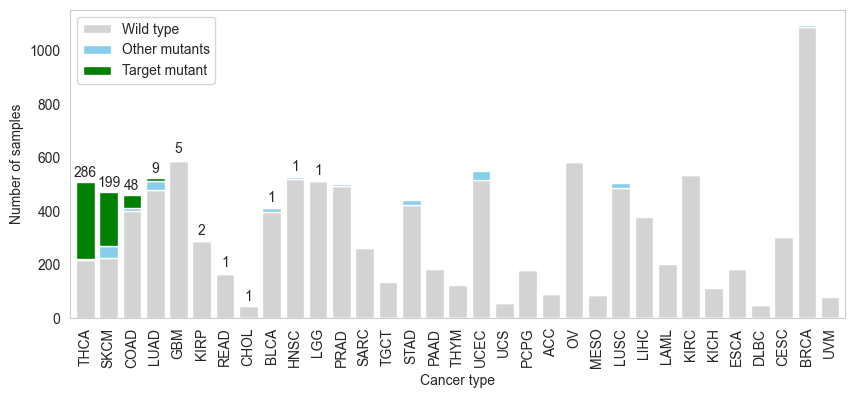

In [124]:
sns.set_style("whitegrid", {'axes.grid' : False})
#Mutation frequency
fig,cancers_df=av.get_cancer_mutation_freq(barcode_df,mut_f,driver_gene,driver_mut,cancers)

##### Save the graph

In [125]:
fig.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,"_frequency_across_cancers",".png"), dpi=600,format='png')

#### Show the mutation frequency as a table

In [126]:
cancers_df

,Wild type,Other mutants,Target mutant
THCA,216,5,286
SKCM,223,48,199
COAD,401,10,48
LUAD,480,33,9
GBM,587,4,5
KIRP,286,3,2
READ,164,5,1
CHOL,44,0,1
BLCA,397,14,1
HNSC,518,9,1


In [127]:
tbl_file = tbl_folder+av.gen_filename(driver_gene,driver_mut,"_frequency_across_cancers",".tsv")
cancers_df.to_csv(tbl_file,sep='\t')

### Define binding partners

#### upload binding partners from file

In [128]:
ppi_f = data_folder + "BRAF_hc_go_ppis.txt"
partners = av.get_binding_partners(ppi_f)
print("There are", len(partners), "partners")

There are 154 partners


#### or provide binding partners manually

In [17]:
#partners = ['AURKA', 'NEFL', 'SERPINB13']
#for partner in partners:
#    if partner not in genes_with_expression:
#        print(partner,"not in MUT/EXP dataset. Check gene name.")

In [129]:
#get detailed info for the binding prtners
partner_hgnc_df = hgnc_df.loc[partners]
partner_hgnc_df = partner_hgnc_df[['HGNC ID','Approved name','Previous symbols','Alias symbols','Accession numbers',
                                   'RefSeq IDs','Alias names','Previous name','NCBI Gene ID','Ensembl gene ID',
                                   'OMIM ID(supplied by OMIM)','RefSeq(supplied by NCBI)','UniProt ID(supplied by UniProt)']]
partner_hgnc_df.columns = ['HGNC ID','Approved name','Previous symbols','Alias symbols','Accession numbers',
                           'RefSeq IDs','Alias names','Previous name','NCBI Gene ID','Ensembl gene ID','OMIM ID','RefSeq','UniProt ID']
partner_hgnc_df.to_csv(tbl_folder+"binding_partners.csv",sep=',')
partner_hgnc_df.head()

,HGNC ID,Approved name,Previous symbols,Alias symbols,Accession numbers,RefSeq IDs,Alias names,Previous name,NCBI Gene ID,Ensembl gene ID,OMIM ID,RefSeq,UniProt ID
Approved symbol,,,,,,,,,,,,,
ACVR1B,HGNC:172,activin A receptor type 1B,ACVRLK4,"ALK4, SKR2, ActRIB",NaN,NM_020328,NaN,"activin A receptor, type IB",91,ENSG00000135503,601300,NM_004302,P36896
AJUBA,HGNC:20250,ajuba LIM protein,JUB,MGC15563,AK025567,NaN,NaN,"jub, ajuba homolog (Xenopus laevis)",84962,ENSG00000129474,609066,NM_001289097,Q96IF1
AKT1,HGNC:391,AKT serine/threonine kinase 1,NaN,"RAC, PKB, PRKBA, AKT, RAC-alpha",M63167,NM_005163,protein kinase B,v-akt murine thymoma viral oncogene homolog 1,207,ENSG00000142208,164730,NM_001014431,P31749
ALK,HGNC:427,ALK receptor tyrosine kinase,NaN,"CD246, ALK1",D45915,NM_004304,NaN,"anaplastic lymphoma kinase (Ki-1), ""anaplastic...",238,ENSG00000171094,105590,NM_001353765,Q9UM73
APH1A,HGNC:29509,"aph-1 homolog A, gamma-secretase subunit",NaN,"APH-1A, CGI-78",AF151835,NM_016022,NaN,anterior pharynx defective 1 homolog A (C. ele...,51107,ENSG00000117362,607629,NM_001077628,Q96BI3


### Indicate the cancer type for the analysis

In [130]:
cancer = 'SKCM'

### Get cancer samples with and without driver mutations

#### Extract the data from TCGA files

In [131]:
df_mut_exp_samples,df_wt_exp_samples =av.get_wt_mut_expression(mut_f,exp_f,coding_genes,barcode_df,cancer,driver_gene,driver_mut,tbl_folder)

Total samples: 470


In [132]:
df_mut_exp_samples.head()

,TCGA-BF-A1PU,TCGA-BF-A1PX,TCGA-BF-A3DJ,TCGA-BF-A3DL,TCGA-BF-A3DM,TCGA-BF-A3DN,TCGA-BF-A5EQ,TCGA-BF-A5ER,TCGA-BF-A9VF,TCGA-BF-AAP0,TCGA-BF-AAP6,TCGA-BF-AAP7,TCGA-D3-A1Q4,TCGA-D3-A1Q5,TCGA-D3-A1Q6,TCGA-D3-A1Q7,TCGA-D3-A1Q9,TCGA-D3-A2J7,TCGA-D3-A2JA,TCGA-D3-A2JD,TCGA-D3-A2JE,TCGA-D3-A2JG,TCGA-D3-A2JK,TCGA-D3-A2JN,TCGA-D3-A2JP,TCGA-D3-A3C1,TCGA-D3-A3C3,TCGA-D3-A3C6,TCGA-D3-A3C7,TCGA-D3-A3CB,TCGA-D3-A3CE,TCGA-D3-A3MO,TCGA-D3-A3MR,TCGA-D3-A3MU,TCGA-D3-A51J,TCGA-D3-A51N,TCGA-D3-A5GN,TCGA-D3-A5GR,TCGA-D3-A5GS,TCGA-D3-A5GT,TCGA-D3-A5GU,TCGA-D3-A8GB,TCGA-D3-A8GD,TCGA-D3-A8GJ,TCGA-D3-A8GN,TCGA-D3-A8GO,TCGA-D3-A8GS,TCGA-D3-A8GV,TCGA-D9-A148,TCGA-D9-A1JX,TCGA-D9-A3Z3,TCGA-D9-A4Z2,TCGA-D9-A6E9,TCGA-D9-A6EG,TCGA-DA-A1HW,TCGA-DA-A1HY,TCGA-DA-A1I0,TCGA-DA-A1I2,TCGA-DA-A1I4,TCGA-DA-A1I5,TCGA-DA-A1I7,TCGA-DA-A1I8,TCGA-DA-A3F5,TCGA-DA-A3F8,TCGA-DA-A95W,TCGA-EB-A24C,TCGA-EB-A299,TCGA-EB-A3HV,TCGA-EB-A3XB,TCGA-EB-A3XD,TCGA-EB-A3XE,TCGA-EB-A3XF,TCGA-EB-A3Y6,TCGA-EB-A42Z,TCGA-EB-A430,TCGA-EB-A431,TCGA-EB-A44N,TCGA-EB-A44P,TCGA-EB-A4IS,TCGA-EB-A4P0,TCGA-EB-A550,TCGA-EB-A553,TCGA-EB-A5FP,TCGA-EB-A5SE,TCGA-EB-A5UN,TCGA-EB-A6QY,TCGA-EB-A6QZ,TCGA-EB-A6R0,TCGA-EB-A85I,TCGA-EE-A17Y,TCGA-EE-A183,TCGA-EE-A20B,TCGA-EE-A20F,TCGA-EE-A20H,TCGA-EE-A29A,TCGA-EE-A29C,TCGA-EE-A29E,TCGA-EE-A29H,TCGA-EE-A29M,TCGA-EE-A29P,TCGA-EE-A29T,TCGA-EE-A29W,TCGA-EE-A2A6,TCGA-EE-A2GB,TCGA-EE-A2GE,TCGA-EE-A2GH,TCGA-EE-A2GS,TCGA-EE-A2GT,TCGA-EE-A2M5,TCGA-EE-A2M6,TCGA-EE-A2M7,TCGA-EE-A2M8,TCGA-EE-A2ME,TCGA-EE-A2MG,TCGA-EE-A2MH,TCGA-EE-A2MK,TCGA-EE-A2MP,TCGA-EE-A3AB,TCGA-EE-A3AD,TCGA-EE-A3AF,TCGA-EE-A3AG,TCGA-EE-A3AH,TCGA-EE-A3J3,TCGA-EE-A3J4,TCGA-EE-A3JB,TCGA-EE-A3JE,TCGA-ER-A198,TCGA-ER-A19B,TCGA-ER-A19C,TCGA-ER-A19E,TCGA-ER-A19G,TCGA-ER-A19H,TCGA-ER-A19J,TCGA-ER-A19K,TCGA-ER-A19M,TCGA-ER-A19O,TCGA-ER-A19P,TCGA-ER-A19Q,TCGA-ER-A19S,TCGA-ER-A2NC,TCGA-ER-A2ND,TCGA-ER-A2NG,TCGA-ER-A3PL,TCGA-ER-A42K,TCGA-ER-A42L,TCGA-FR-A44A,TCGA-FR-A728,TCGA-FR-A729,TCGA-FR-A7UA,TCGA-FR-A8YE,TCGA-FS-A1YX,TCGA-FS-A1YY,TCGA-FS-A1Z7,TCGA-FS-A1ZC,TCGA-FS-A1ZD,TCGA-FS-A1ZF,TCGA-FS-A1ZH,TCGA-FS-A1ZM,TCGA-FS-A1ZN,TCGA-FS-A1ZR,TCGA-FS-A1ZS,TCGA-FS-A4F8,TCGA-FS-A4FB,TCGA-FW-A3TV,TCGA-FW-A5DX,TCGA-GF-A2C7,TCGA-GF-A4EO,TCGA-GF-A6C8,TCGA-GF-A6C9,TCGA-GF-A769,TCGA-GN-A262,TCGA-GN-A263,TCGA-GN-A265,TCGA-GN-A26A,TCGA-GN-A4U5,TCGA-GN-A4U7,TCGA-GN-A4U8,TCGA-GN-A9SD,TCGA-HR-A2OH,TCGA-HR-A5NC,TCGA-IH-A3EA,TCGA-LH-A9QB,TCGA-OD-A75X,TCGA-QB-A6FS,TCGA-W3-AA1Q,TCGA-W3-AA1R,TCGA-W3-AA1W,TCGA-W3-AA21,TCGA-WE-A8K5,TCGA-WE-A8K6,TCGA-WE-A8ZQ,TCGA-WE-A8ZR,TCGA-WE-A8ZT,TCGA-WE-A8ZX,TCGA-WE-AAA0,TCGA-WE-AAA4,TCGA-XV-A9W5,TCGA-XV-AAZV,TCGA-XV-AAZW,TCGA-YD-A9TB,TCGA-YG-AA3N,TCGA-Z2-A8RT,TCGA-Z2-AA3V
gene_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
EZHIP,0.000000,0.000000,1.445303,0.000000,0.971516,0.902961,0.523361,0.000000,1.843903,0.487795,1.539630,1.873223,2.244735,9.760490,0.546364,0.658737,5.816451,0.000000,0.000000,0.000000,0.000000,0.459851,0.000000,0.000000,0.000000,1.592684,4.596971,0.000000,0.000000,1.389952,3.084439,3.150901,0.945233,0.000000,0.819259,0.702835,0.000000,0.842134,0.000000,0.000000,0.000000,2.725196,3.459576,0.000000,2.137962,3.319531,2.887974,2.984152,0.000000,0.000000,0.443819,0.414677,0.000000,0.372841,0.361993,2.451488,0.000000,0.303109,1.492417,2.293282,0.000000,3.491353,2.793584,0.715542,2.808632,0.000000,1.975594,1.337369,0.000000,0.000000,1.035905,0.000000,0.803806,0.000000,0.000000,0.000000,1.116032,2.532242,1.063986,0.000000,2.430928,0.000000,0.000000,0.000000,1.872159,0.811307,0.000000,5.370890,1.121214,0.000000,0.781737,0.000000,2.794977,2.777641,0.000000,0.000000,0.000000,1.228542,0.422233,1.273695,2.088888,0.781905,0.414569,3.675172,0.748461,1.924062,1.754417,0.979513,0.000000,0.368265,1.057624,0.809003,1.651362,1.589188,1.101650,0.843180,6.577912,1.408549,2.235635,0.000000,0.363451,0.000000,0.000000,0.000000,0.927138,1.882917,0.000000,

### Calculate PPI scores

In [133]:
all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(tbl_folder,
                                                              cancer,driver_gene,driver_mut,partners,df_mut_exp_samples,
                                                              df_wt_exp_samples)

In [134]:
all_mut_score_nn_df.head()

,ACVR1B,AJUBA,AKT1,ALK,APH1A,ARAF,ARPC1A,ARRB2,ASXL1,ATG14,ATP5F1B,AURKA,AURKB,BABAM2,BCL2L1,BCL2L2,BCOR,BTK,C3ORF70,CCDC120,CCN6,CCND2,CD1D,CD79B,CDK4,CDK6,CDKN2B,CHD1L,CHI3L1,CNKSR1,CTLA4,CUL4B,CYBB,DIS3,DLL3,DUOX2,E2F2,E2F4,E2F6,E2F7,E2F8,EFNA3,EIF5A2,ELF5,EMSY,ERBB3,ERCC2,ERRFI1,ETV1,EZH1,EZH2,FANCA,FANCC,FANCE,FANCF,FANCL,FOXO3,GABRA6,GATAD2B,GCK,GID4,GNA11,GNA13,GNAQ,GOT1,GPC5,GSK3B,GUSB,HDAC1,HDAC3,HK1,HLA-B,IGF1R,INHBA,IRF2,IRF6,ITPKB,JAK1,JAK3,KDM5A,KEAP1,KLHL9,KRAS,LATS1,LZTR1,MAGEA6,MAPK10,MAPK12,MAPK13,MAPK6,MAPK7,MCL1,SCG2,MTOR,MUTYH,NEFL,NFATC1,NFKBIA,NOS3,NOX1,NQO1,NTN4,OTUD7A,PDK1,PIAS3,PIK3CG,PLCG2,POLD1,POLE,POU2AF1,PPARA,PPARD,PPM1D,PRDM1,PREX2,PRKAB2,PRSS8,PTK6,RAB25,RALGDS,RASSF7,RHEB,RPL5,RPTOR,RTEL1,SDHA,SDHB,SEMA4F,SEMA6A,SERPINB13,SIRT4,SLC4A5,SMARCB1,SMO,SMURF1,SNAPIN,SOCS1,SOX9,SRSF2,STAG2,TBL1XR1,TEAD1,TEAD3,TEAD4,TENT5C,TGFBR2,THRA,TNFRSF14,TP53,TRIB1,TSC2,VHL,WEE1,ZNF483
TCGA-BF-A1PU,7.394096,6.600685,9.439244,6.344534,9.001636,8.258189,9.225156,7.696436,8.675078,7.433441,9.574545,7.733054,7.407616,7.348722,9.208609,8.248053,7.741847,4.834855,7.560791,7.068803,3.746028,6.322544,4.760958,6.290588,8.640810,8.065972,6.721988,8.336612,6.252246,4.353577,3.951949,8.006205,5.288814,7.722143,8.125209,3.746028,6.808931,8.266835,6.775160,7.105165,5.046398,6.080795,7.053566,3.456697,7.317368,9.814418,8.129232,7.074336,7.447659,7.972776,6.874151,7.615725,7.435352,6.743480,6.950040,7.040910,8.251600,2.966136,7.842212,3.889613,7.221292,7.857262,8.034631,8.505441,7.836212,3.327106,8.581332,8.690326,8.504467,8.073696,8.868463,9.521750,9.340834,5.424871,7.717403,5.655121,9.364192,8.380803,6.527224,7.850583,8.578402,7.656809,7.212895,6.849841,8.066211,3.327106,4.418956,7.547013,5.144225,7.574304,7.918172,8.913940,7.170059,8.338662,6.535113,4.610034,8.027944,7.782799,7.690898,2.966136,9.217744,5.342885,4.869143,6.432119,7.921112,4.009324,7.221935,8.133239,7.823225,4.009324,7.928378,8.097342,7.511828,5.545876,4.478907,7.459297,5.132697,5.614579,5.334151,8.408580,6.489256,7.907596,9.224169,8.474916,7.805899,8.931430,7.811418,7.291031,8.628406,4.418956,5.155572,5.614579,8.539805,8.183851,8.024646,7.608146,4.760958,6.219518,8.573945,7.771804,7.778065,8.606524,7.370983,7.353015,5.288814,9.097380,8.000283,8.106852,9.194291,8.738620,8.684096,7.346025,7.273921,4.741235
TCGA-BF-A1PX,8.623550,7.894561,9.501547,5.262790,9.311783,8.510316,8.839740,8.494276,8.635333,7.515929,10.237680,8.075671,8.235862,7.697549,8.977142,8.327085,8.140688,7.354944,7.524367,7.845655,3.661850,8.797197,5.915248,6.899412,9.305598,8.118025,8.194275,8.623699,8.238204,7.131897,6.441199,8.510495,8.225092,7.906076,7.134302,6.351071,7.937606,8.430102,7.867270,6.811092,6.524110,7.672370,7.214867,4.240449,7.234983,10.014225,7.761693,7.369820,7.930873,7.869440,7.759678,7.527354,7.322392,7.344256,7.237067,7.752947,8.308235,3.281123,8.171266,4.837214,7.514514,7.599959,8.413379,8.273204,8.250316,4.093875,8.606595,9.158781,8.894389,8.323866,9.448310,11.534956,9.169080,5.660402,8.210389,7.960879,8.734444,9.235169,8.090811,8.386379,8.857687,7.241222,7.645692,6.776447,8.304453,5.660402,4.170879,7.713617,8.451877,8.227734,8.129850,9.425273,6.365155,8.713908,7.391573,6.797812,7.905359,8.705935,8.156057,3.281123,8.443910,6.887680,4.892988,7.557834,8.206869,6.468902,7.772180,8.359430,8.717395,7.231843,7.523669,8.686798,7.386938,7.439919,5.059956,7.644509,7.682547,7.927282,8.799707,8.825951,7.295056,8.630670,9.970663,8.483630,7.941121,9.221867,8.435065,7.465398,8.771482,8.082153,5.470805,6.686261,8.803873,7.964685,7.904695,7.965065,7.074246,7.862911,8.952841,8.215502,8.475825,8.007079,7.820596,7.703027,7.840262,8.860106,7.970256,9.284249,8.959767,9.459869,8.695120,7.689810,7.639162,4.240449
TCGA-BF-A3DJ,8.299024,7.152809,9.007092,5.998205,9.302506,8.403514,9.448314,8.237568,8.757356,7.670013,10.145997,7.675412,7.356883,7.994533,9.051041,8.351464,8.505702,7.015690,7.938409,7.354790,4.931272,7.546162,6.174275,5.694993,9.417669,8.593496,6.770224,8.885040,8.936692,6.057582,5

#### Heatmap of co-regulated neoPPIs

Average correlation: 0.44693715004377826


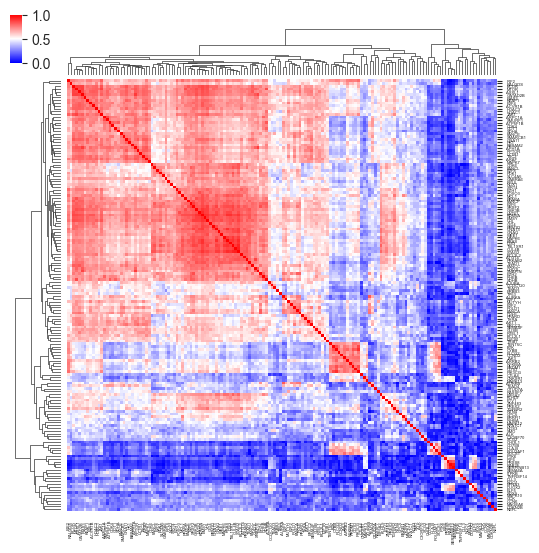

In [136]:
#co-regulated neoPPIs
import numpy as np
corr = all_mut_score_nn_df.corr()
for i in corr.index:
    for c in corr.columns:
        corr[c].loc[i] = abs(corr[c].loc[i])
g = sns.clustermap(data=corr,cmap='bwr',method='average',xticklabels=1,yticklabels=1,
                  dendrogram_ratio=(.1, 0.1),row_cluster=True,col_cluster=True,figsize=(6,6),
                  cbar_kws=dict(ticks=[0, 0.50, 1], orientation='vertical'),vmin = 0, vmax=1.0)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xmajorticklabels(), fontsize = 3);
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize = 3);
x0, _y0, _w, _h = g.cbar_pos
g.ax_cbar.set_position([x0, g.ax_col_dendrogram.get_position().y0+0.02, 0.02,g.ax_col_dendrogram.get_position().height])
g.savefig(fig_folder+cancer+"_PPI_score_corr_matrix.pdf",dpi=300,format='pdf')

#Average correlation between neoPPI scores
n = 0
arr = []
for i in range(0,len(corr.index.values)):
    for c in range(i,len(corr.columns.values)):
        if i != c:
            n+=1
            arr.append(corr.iloc[i,c])
print("Average correlation:", np.mean(arr))


#### Distribution of the neoPPI cross correlations

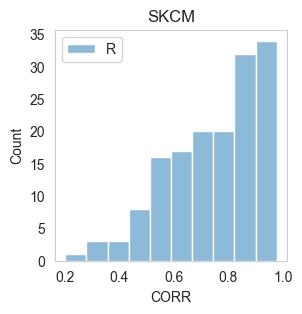

In [137]:
import scipy.stats as ss
import seaborn as sns
sns.set_style("whitegrid", {'axes.grid' : False})

out = []
for gene in all_mut_score_nn_df.columns:
    if gene in df_mut_exp_samples.index:
        v1 = all_mut_score_nn_df[gene].values
        v2 = df_mut_exp_samples.loc[gene].values
        v1a = []
        v2a = []
        for l, n in zip(v1, v2):
            if (str(l)!='nan') and (str(n)!='nan'):
                v1a.append(l)
                v2a.append(n)
                
        
        r,p = ss.pearsonr(v1a,v2a)
        if r != 0:
            out.append([gene,abs(r)])
out_df = pd.DataFrame(out,columns=['GENE','R'])
fig, ax = plt.subplots(figsize=(3,3))
sns.histplot(data = out_df,ax=ax,bins=10)
ax.set_xlabel("CORR")
ax.set_title(cancer)
fig.savefig(fig_folder+cancer+"_hist.pdf",dpi=300,format='pdf')


### Calculate PPI scores for multiple cancer types

In [138]:
ppi_score_dict = dict()
for cancer in ['THCA','COAD','SKCM']:
    print(cancer)
    df_mut_exp_samples,df_wt_exp_samples = av.get_wt_mut_expression(mut_f,exp_f,coding_genes,barcode_df,cancer,driver_gene,driver_mut,
                                                                    tbl_folder)
    all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(tbl_folder,
                                                              cancer,driver_gene,driver_mut,partners,df_mut_exp_samples,
                                                              df_wt_exp_samples)
    ppi_score_dict[cancer] = [all_mut_score_nn_df,df_mut_exp_samples]


THCA
Total samples: 507
COAD
Total samples: 459
SKCM
Total samples: 470


#### Coompare PPI scores across different cancer types

In [139]:
out_df=av.compare_ppi_scores(ppi_score_dict,partners)
out_df.head()

,THCA_AVR,THCA_SD,PVAL_THCA-COAD,FC_THCA-COAD,PVAL_THCA-SKCM,FC_THCA-SKCM,COAD_AVR,COAD_SD,PVAL_COAD-SKCM,FC_COAD-SKCM,SKCM_AVR,SKCM_SD,KW_H_Test_PVAL,KW_H_Test_QVAL
ACVR1B,8.456991,0.309737,1.987746e-01,1.008201,4.116987e-02,1.010720,8.388196,0.443811,8.470555e-01,1.002498,8.367292,0.497063,2.678708e-02,2.769821e-02
AJUBA,8.743035,0.370629,2.548610e-17,1.129705,2.097764e-76,1.196834,7.739222,0.516364,2.140186e-02,1.059422,7.305133,0.655500,2.975451e-79,3.768905e-78
AKT1,9.739336,0.233975,9.548044e-19,1.069298,8.778328e-03,0.990041,9.108160,0.398429,8.823178e-24,0.925880,9.837306,0.396082,2.683759e-23,4.799193e-23
ALK,6.535202,0.694864,1.444647e-24,1.811802,2.793369e-03,0.960520,3.607017,0.586196,3.259369e-31,0.530146,6.803814,1.044866,9.864432e-31,2.498989e-30
APH1A,9.949426,0.271674,6.969209e-23,1.071367,2.319527e-07,1.019769,9.286666,0.300658,3.625890e-11,0.951839,9.756550,0.446244,5.326751e-24,9.755013e-24


In [140]:
#Save it!
out_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,'COAD_SKCM_THCA','_AVR_neoPPIscores.csv'),sep=',')

### Build the heatmaps

#### neoPPI scores averaged across cancer types

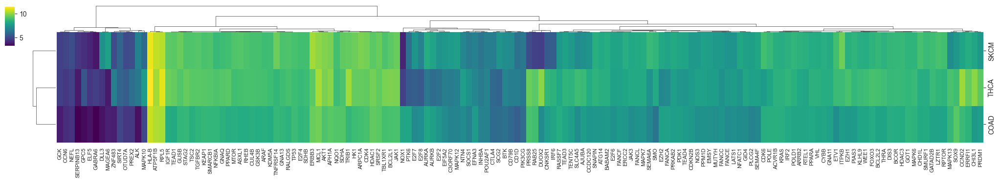

In [141]:
g=av.get_neo_ppi_score_heatmap(out_df)

In [142]:
#Save the figure
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,'COAD_SKCM_THCA','_neoPPI_heatmap.png')
g.savefig(fig_file, dpi=600,format='png')

#### neoPPI scores per tumor sample

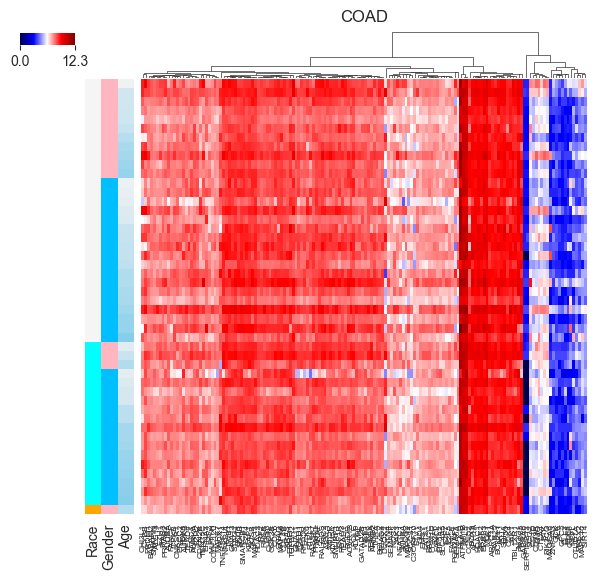

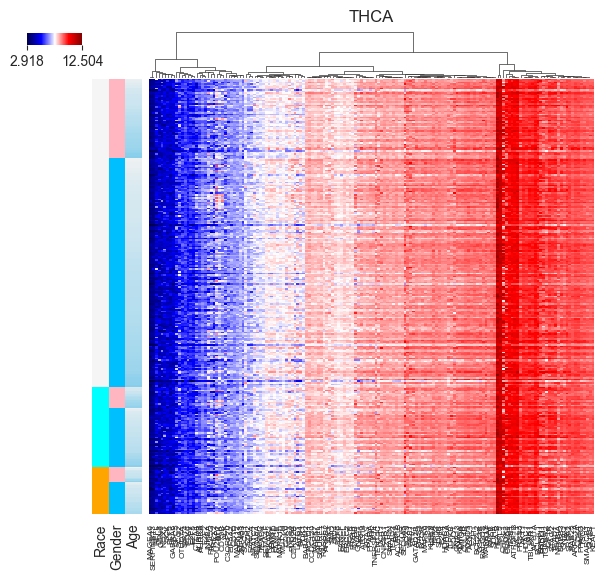

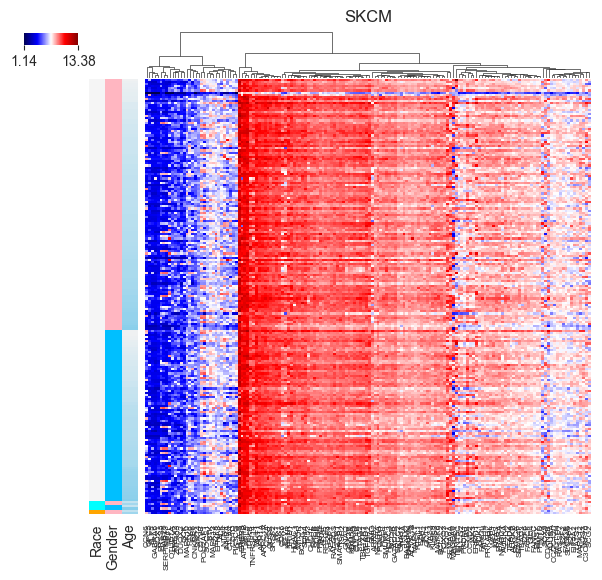

In [143]:
out = {}
for cancer in ['COAD','THCA','SKCM']:
    g,out_df = av.build_heatmap(cancer,ppi_score_dict,clinical_f,driver_gene,driver_mut,fig_folder,['Race','Gender','Age'])
    out[cancer]=out_df

#### Show box plots neoPPI score distribution

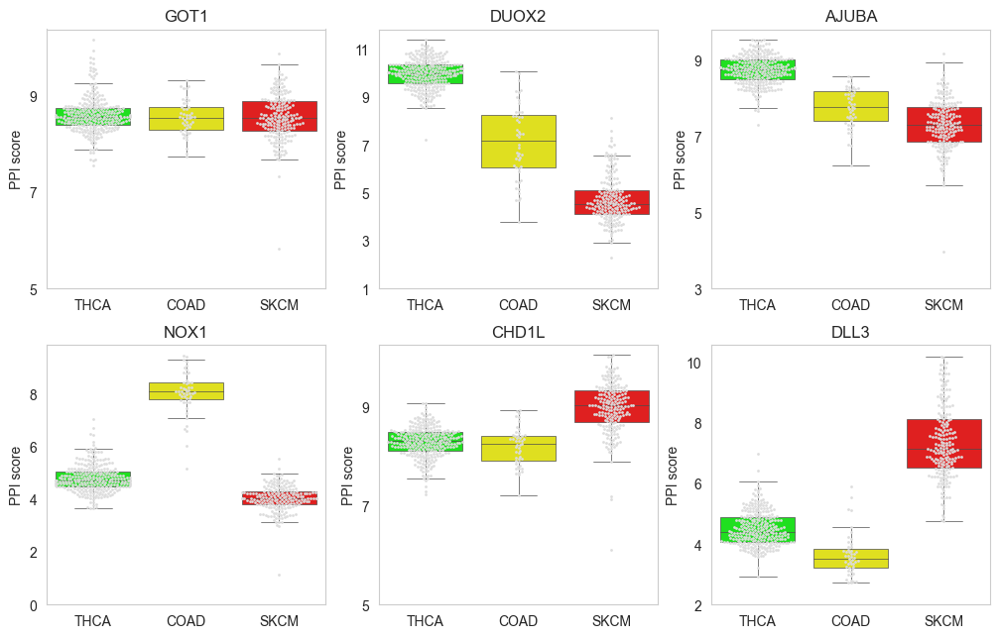

In [144]:
cancers = ['THCA','COAD','SKCM']
genes = ['GOT1','DUOX2','AJUBA','NOX1','CHD1L','DLL3']
colors = ['#00FF00', '#FFFF00', '#FF0000']
fig=av.boxplot_neoppi_score_distribution(genes,cancers,ppi_score_dict,colors,'gainsboro')

In [145]:
#Save it
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,'COAD_SKCM_THCA',"_neoPPI_distribution_boxplots1.pdf")
fig.savefig(fig_file, dpi=600,format='pdf')

In [146]:
#Get the PPIScore values
ppi_score_dict['SKCM'][0].sort_values(by=['AURKA'],ascending=False).head()

,ACVR1B,AJUBA,AKT1,ALK,APH1A,ARAF,ARPC1A,ARRB2,ASXL1,ATG14,ATP5F1B,AURKA,AURKB,BABAM2,BCL2L1,BCL2L2,BCOR,BTK,C3ORF70,CCDC120,CCN6,CCND2,CD1D,CD79B,CDK4,CDK6,CDKN2B,CHD1L,CHI3L1,CNKSR1,CTLA4,CUL4B,CYBB,DIS3,DLL3,DUOX2,E2F2,E2F4,E2F6,E2F7,E2F8,EFNA3,EIF5A2,ELF5,EMSY,ERBB3,ERCC2,ERRFI1,ETV1,EZH1,EZH2,FANCA,FANCC,FANCE,FANCF,FANCL,FOXO3,GABRA6,GATAD2B,GCK,GID4,GNA11,GNA13,GNAQ,GOT1,GPC5,GSK3B,GUSB,HDAC1,HDAC3,HK1,HLA-B,IGF1R,INHBA,IRF2,IRF6,ITPKB,JAK1,JAK3,KDM5A,KEAP1,KLHL9,KRAS,LATS1,LZTR1,MAGEA6,MAPK10,MAPK12,MAPK13,MAPK6,MAPK7,MCL1,SCG2,MTOR,MUTYH,NEFL,NFATC1,NFKBIA,NOS3,NOX1,NQO1,NTN4,OTUD7A,PDK1,PIAS3,PIK3CG,PLCG2,POLD1,POLE,POU2AF1,PPARA,PPARD,PPM1D,PRDM1,PREX2,PRKAB2,PRSS8,PTK6,RAB25,RALGDS,RASSF7,RHEB,RPL5,RPTOR,RTEL1,SDHA,SDHB,SEMA4F,SEMA6A,SERPINB13,SIRT4,SLC4A5,SMARCB1,SMO,SMURF1,SNAPIN,SOCS1,SOX9,SRSF2,STAG2,TBL1XR1,TEAD1,TEAD3,TEAD4,TENT5C,TGFBR2,THRA,TNFRSF14,TP53,TRIB1,TSC2,VHL,WEE1,ZNF483
TCGA-FW-A5DX,9.098683,7.701109,10.099419,8.065701,10.422845,9.707950,10.945502,8.855852,10.378116,8.559606,10.879112,9.756476,8.742173,8.920688,9.545359,9.160729,9.540289,7.800771,9.358549,8.719664,6.896632,7.361108,6.706706,7.187206,10.237849,10.188345,10.363305,9.708113,8.740325,6.300842,6.706706,10.273346,8.604934,9.795776,9.741689,4.902801,8.627658,8.996798,9.045305,9.058925,7.894331,6.582843,8.068840,4.592368,8.625489,11.519036,8.558020,9.318701,10.068372,9.096050,9.688985,8.836927,8.734747,7.957309,8.582243,10.052423,8.883198,4.366440,9.632481,4.764157,8.674450,8.764002,9.653325,9.878861,9.298204,4.366440,9.770077,10.875827,9.984788,9.204023,10.149595,10.117202,10.191407,6.557846,9.106899,4.764157,10.372935,10.470702,7.114574,9.570594,9.386050,9.366623,9.540494,8.053012,9.618537,10.094715,5.584761,8.197005,6.727107,9.757681,8.922104,10.476342,7.421183,10.133851,8.033988,4.366440,9.472226,8.442800,8.312004,4.902801,8.766984,8.401554,5.019075,9.211770,9.189932,7.013804,7.233522,9.156748,9.863546,7.313640,9.645622,9.771111,8.424867,7.339919,5.795719,9.431725,7.233522,5.795719,4.902801,9.278572,8.265027,10.221563,11.081562,9.338093,9.336939,10.542568,9.585087,8.852690,9.258391,4.592368,6.066927,7.292870,9.400775,9.702117,9.613953,8.819177,5.718566,8.439999,10.112940,10.525937,9.977381,10.049724,8.402541,8.273330,9.240411,9.116123,9.193901,10.209557,8.763406,10.337948,9.725488,9.366623,9.462765,6.957593
TCGA-EE-A3AG,9.084722,8.012575,10.337733,7.723713,10.138285,9.470993,10.568501,9.849874,10.094123,9.197222,11.376728,9.627336,9.302304,9.096296,9.411905,9.568202,9.180915,6.708699,9.034559,8.226185,8.309671,7.013196,7.864873,6.220617,10.463580,10.825505,9.706568,9.326881,8.671293,7.002547,7.803946,9.428438,8.486664,9.711169,7.490404,6.389495,8.904547,10.018469,8.862242,8.182607,8.471425,7.957638,7.325673,4.550311,8.812518,10.489384,8.897214,10.502158,9.657167,9.183267,8.249410,9.182818,8.429639,8.705995,8.784949,9.197321,8.982026,4.368585,9.589419,5.443523,8.397015,8.817733,9.577432,9.205871,9.047588,5.090123,10.450413,10.118221,10.507297,9.564013,10.639553,10.178147,10.427672,6.566610,8.542688,7.294152,9.450026,9.789414,8.948855,9.922517,9.764789,8.893324,9.206882,8.355488,9.562383,9.663092,5.830568,9.267971,8.464391,9.359896,8.536483,10.976479,9.473092,9.999027,8.640209,4.816042,9.243800,8.984780,7.468670,4.368585,9.006107,8.425919,5.288242,9.534799,9.617546,5.977844,7.093156,10.285265,9.812031,5.571227,9.020310,9.195427,8.338856,7.642317,5.162363,8.956041,5.743867,7.156516,4.816042,9.446234,7.946131,8.543955,11.628391,9.787044,9.420334,10.253070,9.805453,8.881527,7.944677,5.443523,6.923257,7.482837,10.208177,9.375455,9.631061,8.757229,6.323860,7.821393,10.383508,9.765252,10.168339,9.950705,8.817733,9.169570,8.689629,9.408854,8.991418,9.073563,8.384492,9.457917,9.906705,9.033276,8.715539,6.337474
TCGA-D3-A3C3,9.108987,8.930617,10.030250,7.520186,10.480466,9.619259,10.391424,9.821889,9.807179,9.055807,11.468737,9.622898,9.883144,9.136468,10.440871,9.005614,10.009772,8.582528,6.503417,9.002080,8.255138,8.789815,8.073529,8.313161,1

#### Get sample details

In [147]:
av.get_sample_info('TCGA-FW-A5DX')

uuid,889ae822-add8-4a10-abe0-50176c858f80
patient barcode,TCGA-FW-A5DX
disease type,Nevi and Melanomas
tissue or organ of origin,"Skin, NOS"
age at diagnosis,71 years 123 days
ajcc pathologic stage,Stage IIIC
race,white
gender,male
ethnicity,not hispanic or latino
vital status,Alive



The data is derived from the NCI GDC Data Portal: https://portal.gdc.cancer.gov


### Survival analysis for neoPPIs

#### Define cancer type for the analysis 

In [152]:
cancer = 'SKCM'
df_mut_exp_samples,df_wt_exp_samples = av.get_wt_mut_expression(mut_f,exp_f,coding_genes,barcode_df,cancer,
                                                                driver_gene,driver_mut,tbl_folder)
all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(tbl_folder,
                                                              cancer,driver_gene,driver_mut,partners,df_mut_exp_samples,
                                                              df_wt_exp_samples)

Total samples: 470


#### Get clinical data for mutant samples

#### Conduct survival analysis and show survival plots

IntProgress(value=0, max=154)

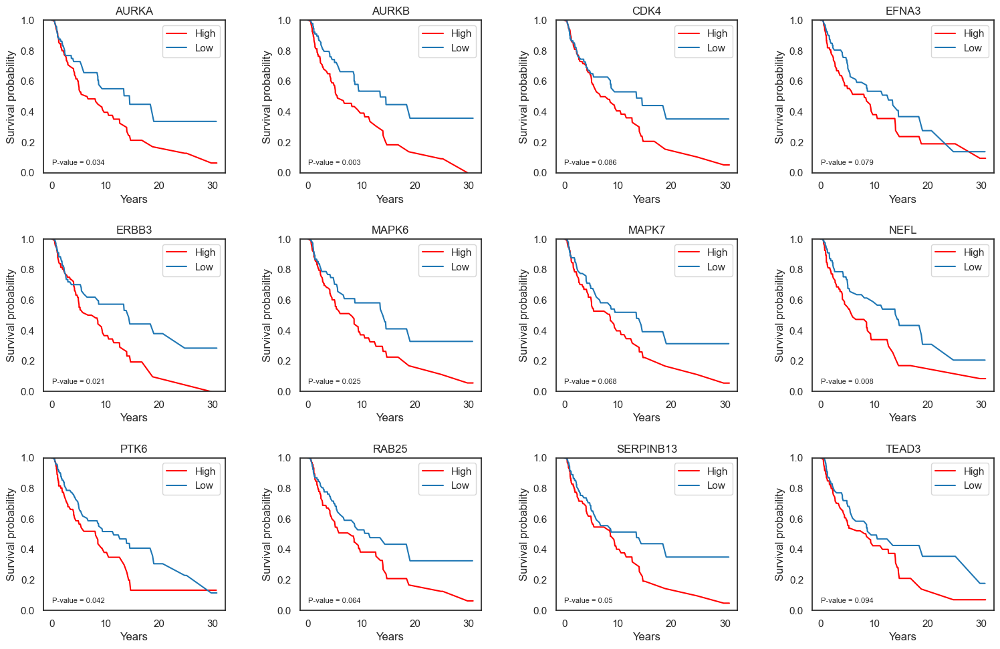

In [153]:
surv_sum_df,fig=av.survival_analysis_with_progress_bar(df_mut_exp_samples.columns,clinical_f,all_mut_score_nn_df,'significant',0.1)

In [154]:
surv_sum_df.head()

,PARTNER,MEDIAN_TIME_HIGH,MEDIAN_TIME_LOW,PVALUE
0,ACVR1B,9.460270,8.599997,0.921690
1,AJUBA,9.257531,8.753421,0.651530
2,AKT1,8.605476,11.567119,0.113435
3,ALK,9.257531,8.753421,0.281036
4,APH1A,8.599997,13.506844,0.306784


In [155]:
#Save it!
surv_sum_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_Survival.csv"),sep=',')
fig.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_Survival_plots.pdf"),dpi=600,format='pdf')

### Get neoPPI-regulated genes

#### Define cancer type for the analysis 

In [156]:
cancer = 'SKCM'
df_mut_exp_samples,df_wt_exp_samples = av.get_wt_mut_expression(mut_f,exp_f,coding_genes,barcode_df,cancer,
                                                                driver_gene,driver_mut,tbl_folder)
all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(tbl_folder,
                                                              cancer,driver_gene,driver_mut,partners,df_mut_exp_samples,
                                                              df_wt_exp_samples)

Total samples: 470


#### Calculate correlations between neoPPI scores and gene expression

In [158]:
corr_dict = av.calculate_correlations(df_mut_exp_samples,df_wt_exp_samples,partners,all_mut_score_nn_df,all_wt_score_nn_df)

IntProgress(value=0, max=154)

In [159]:
corr_dict['AURKA'].head()

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL
GENE,,,,,,,,,,
EZHIP,0.044056,197,0.200441,217,0.538741,0.690778,0.003019,0.008892,0.054250,0.305492
EFCAB8,0.040318,198,0.103823,215,0.572777,0.718608,0.129122,0.222616,0.259923,0.438449
TRIM75,0.064592,200,0.139003,219,0.363513,0.528982,0.039853,0.084602,0.222557,0.423274
GTPBP6,-0.152536,196,-0.168902,210,0.032814,0.085577,0.014260,0.035164,0.433332,0.487076
EFCAB12,-0.226623,195,-0.012712,210,0.001443,0.005946,0.854699,0.905214,0.014820,0.225320


In [161]:
#Save it
folder = tbl_folder+'Correlated_genes/'
if not os.path.exists(folder):
    os.makedirs(folder)
for p in corr_dict.keys():
    corr_dict[p].to_csv(folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+p+"_correlated_genes.csv"),sep=',')

#### or load from file

In [162]:
#Load from file
cancer = 'SKCM'
folder = tbl_folder+'Correlated_genes/'
corr_dict = {}
for partner in partners:
    corr_dict[partner] = pd.read_csv(folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_correlated_genes.csv"),sep=',',index_col=0)

#### Get Signature genes for a single binding partner

In [163]:
#Select the partner:
partner = "AURKA"

In [164]:
from IPython.display import display, HTML
display(HTML("<div style='height: 200px; overflow: auto; width: fit-content'>" +
             corr_dict[partner].sort_values(by=['CORR_BP_MUT'],ascending=False).style.to_html() +
             "</div>"))

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL
GENE,,,,,,,,,,
AURKA,0.806997,196,0.767285,216,0.000000,0.000000,0.000000,0.000000,0.146128,0.382828
TPX2,0.798275,196,0.693081,213,0.000000,0.000000,0.000000,0.000000,0.008051,0.199544
NCAPG2,0.781229,192,0.735489,215,0.000000,0.000000,0.000000,0.000000,0.140308,0.378760
BUB1,0.775636,198,0.815282,215,0.000000,0.000000,0.000000,0.000000,0.137618,0.377059
RACGAP1,0.761237,194,0.731698,212,0.000000,0.000000,0.000000,0.000000,0.252348,0.435762
CSE1L,0.760071,192,0.731143,209,0.000000,0.000000,0.000000,0.000000,0.258703,0.437668
BRAF,0.753731,196,0.736207,219,0.000000,0.000000,0.000000,0.000000,0.345429,0.465841
MCM8,0.753497,194,0.758599,214,0.000000,0.000000,0.000000,0.000000,0.452541,0.491264
CENPI,0.744785,196,0.779465,222,0.000000,0.000000,0.000000,0.000000,0.200644,0.413271


In [165]:
box,sig_genes = av.display_signature_genes(corr_dict,partner,driver_gene)
display(box)
[box.children[0].children[x].observe(av.on_value_change, names='value') for x in range(0,4)];

#### Get Signature genes for multiple binding partners

In [299]:
CORR_BP_MUT = 0.33
PVAL_BP_MUT = 0.05
PVAL = 0.05
QVAL = 0.25
sign_gene_dict = {}
sign_gene_dict,sign_gene_df= av.get_signature_genes_for_multiple_binding_partners(CORR_BP_MUT,PVAL_BP_MUT,
                                                                                  PVAL,QVAL,corr_dict,
                                                                                  cancer,driver_gene,driver_mut)

In [300]:
sign_gene_df.tail()

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL,CANCER,DRIVER,PARTNER
WIPF1,0.333837,198,0.105600,220,1.537021e-06,8.148837e-06,1.183490e-01,1.800052e-01,0.007265,0.151298,SKCM,BRAF_p.V600E,WEE1
MAP3K20,0.460772,196,0.257964,218,1.077884e-11,1.078943e-10,1.170127e-04,3.490181e-04,0.009051,0.162095,SKCM,BRAF_p.V600E,WEE1
ZDHHC13,0.540282,195,0.342532,221,3.585962e-16,6.727074e-15,1.769382e-07,7.454442e-07,0.006181,0.144975,SKCM,BRAF_p.V600E,WEE1
ZNF512,0.545454,192,0.403104,217,2.819977e-16,5.389420e-15,6.938644e-10,3.622415e-09,0.032250,0.240409,SKCM,BRAF_p.V600E,WEE1
ZNF518B,0.398165,197,0.141355,222,6.859388e-09,4.918579e-08,3.530549e-02,6.357141e-02,0.002317,0.106985,SKCM,BRAF_p.V600E,WEE1


In [168]:
#Save it!
sign_gene_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                                               "_signature_genes.csv"),sep=",")

#### COMPARE SIGNATURE GENES OF DIFFERENT NEOPPIS

#### Distribution of the size of neoPPI-regulated gene sets

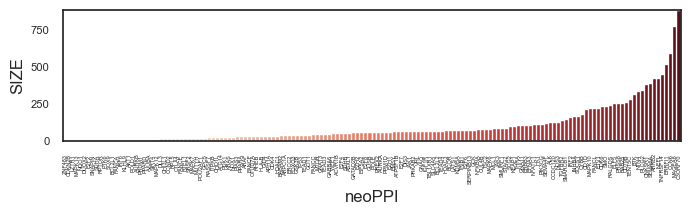

In [169]:
fig, ax = plt.subplots(figsize=(7,2))
plt.tight_layout()
df_stat=av.sig_genes_size(sign_gene_dict)
df_stat.sort_values(by='SIZE',inplace=True)
df_stat.reset_index(inplace=True)
sns.barplot(data=df_stat,x='neoPPI',y='SIZE',ax=ax,palette='Reds',width=1.2) #'bwr'
ax.set_yticklabels(ax.get_ymajorticklabels(), fontsize = 8);
ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize = 4);
ax.set_xticks(ax.get_xticks(), ax.get_xmajorticklabels(), rotation='vertical');
ax.margins(0)

In [170]:
fig.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                                               "_signature_genes_hist.pdf"),dpi=600,format="pdf")

In [171]:
df_stat.sort_values(by='SIZE')

,neoPPI,SIZE
0,ZNF483,0
1,CDKN2B,0
2,LZTR1,0
3,MAPK13,0
4,NQO1,0
5,DUOX2,0
6,E2F2,0
7,SNAPIN,0
11,SOX9,1
10,PTK6,1


#### neoPPI-regulated gene set similarity

Average Jaccard Index:  3.1 %


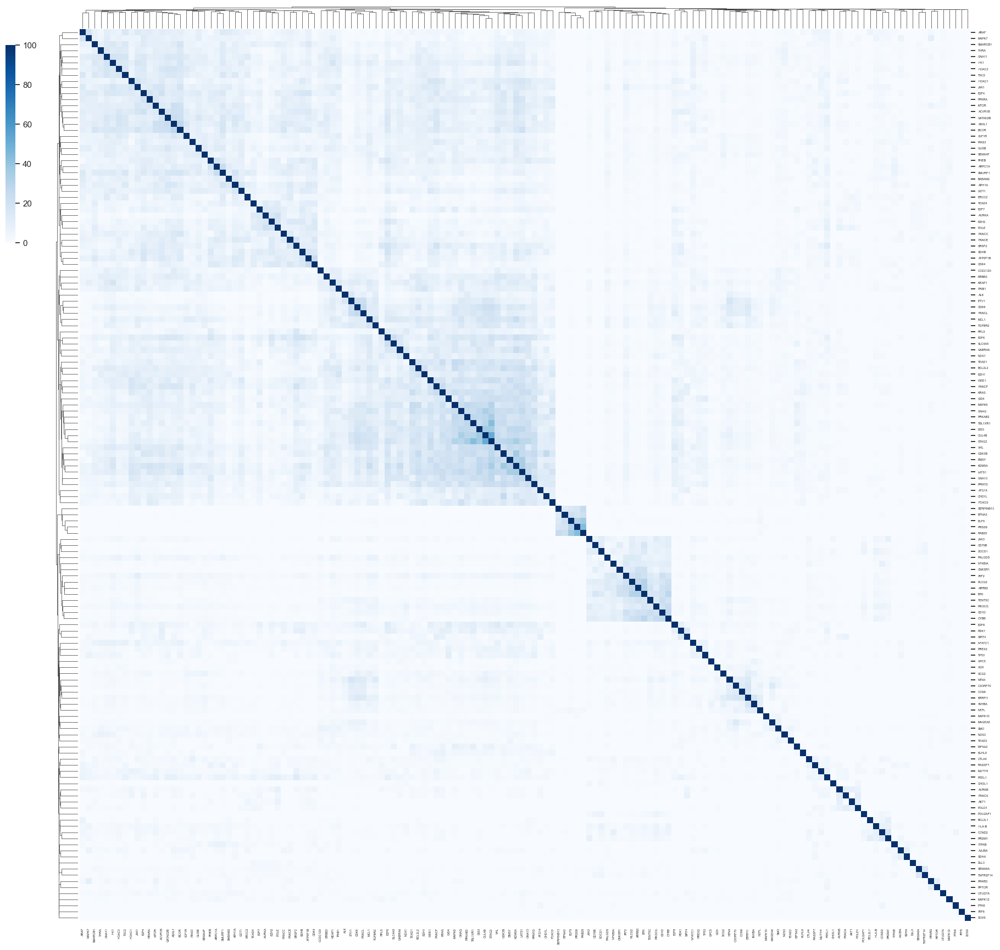

In [182]:
#JACCARD
g=av.jaccard(sign_gene_dict,fig_folder)
g.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_jaccard_heatmap1.pdf"),dpi=600,format='pdf')

#### Overlap of neoPPI-regulated gene sets

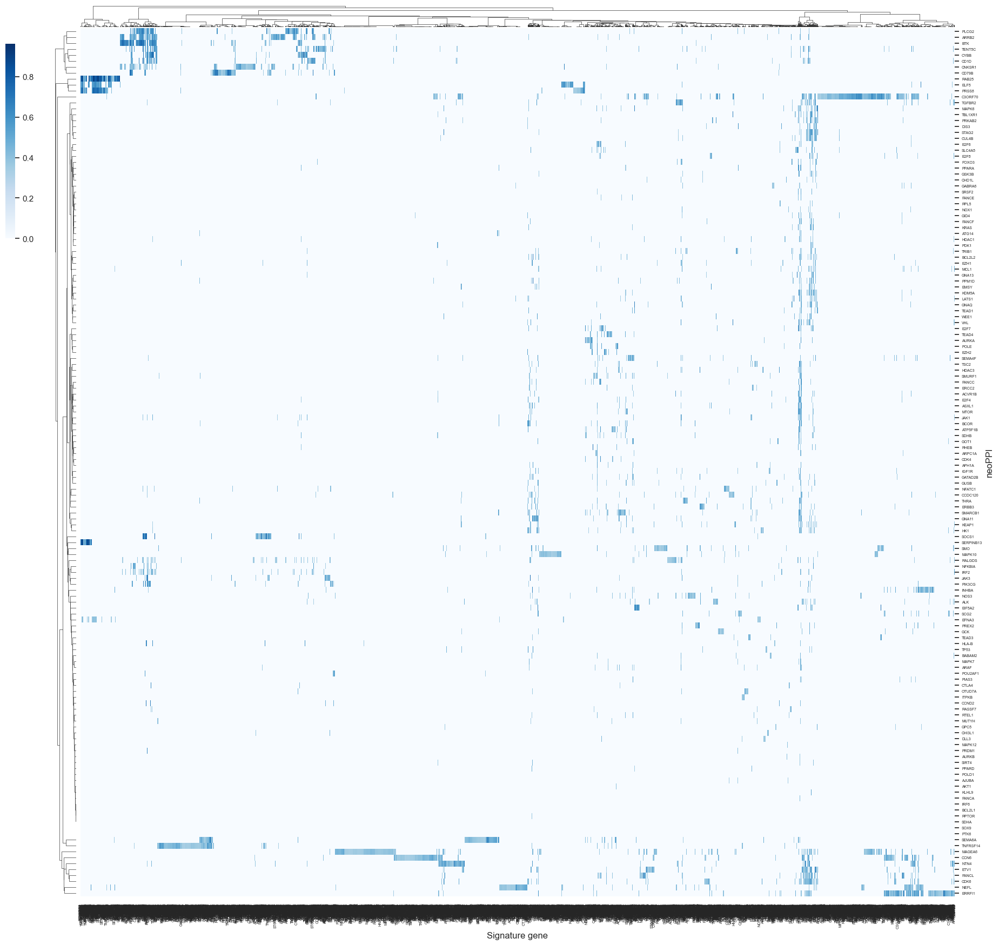

In [179]:
g=av.neoppi_sig_gene_heatmap(sign_gene_df)
g.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_correlation_heatmap.png"),dpi=100,format='png')
#The heatmap shows the correlation coefficients obtained for the neoPPI scores and 
#expression of neoPPI-regulated genes 

#### Build regression plots for a specific signature gene in Mut and WT samples

In [183]:
partner='AURKA'

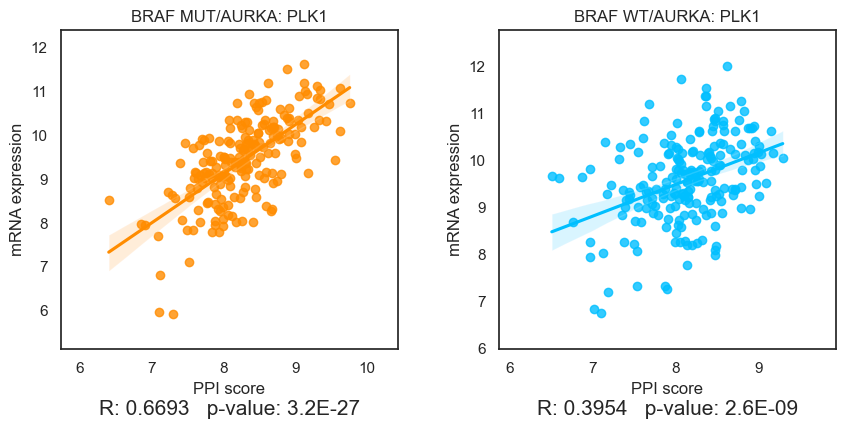

In [184]:
gene = 'PLK1'       
fig = av.ppi_score_mrna_corr(gene,driver_gene,partner,all_mut_score_nn_df,
                       all_wt_score_nn_df,df_mut_exp_samples,df_wt_exp_samples,'darkorange','deepskyblue')

In [185]:
#Save it
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+p+"_"+gene+"_correlattion_plot.png")
fig.savefig(fig_file, dpi=600,format='png')

### Enrichment analysis

#### Define the pathways gene sets to analyze

In [186]:
pathway_files = ["h.all.v2022.1.Hs.symbols.gmt",
         "c2.cp.kegg.v2022.1.Hs.symbols.gmt",
         "c2.cp.reactome.v2022.1.Hs.symbols.gmt"]

In [187]:
#conduct the pathway enrichment analysis
bars_dict,enrichment_dict=av.pathway(sign_gene_dict,pathway_files,partner,coding_genes,pathway_folder)

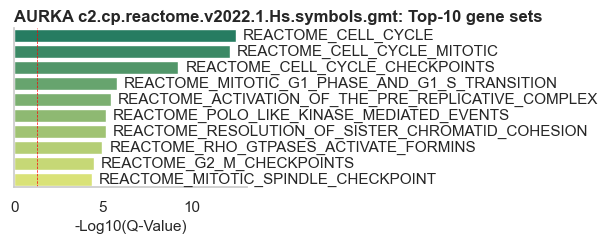

In [188]:
#Show bar graphs
partner = 'AURKA'
pathway = "c2.cp.reactome.v2022.1.Hs.symbols.gmt"
fig = bars_dict[partner][pathway]
fig

In [498]:
#Save it
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_Enrichment_"+
                                      (".").join(pathway.split(".")[:-1])+".png")
fig.savefig(fig_file, dpi=600,format='png')

In [190]:
#Show the enrichment statistics for the pathways with FDR < 5%
neoPPI_enrichment_df=enrichment_dict[partner].loc[enrichment_dict[partner]['fqval']<0.05]

In [191]:
columns = enrichment_dict[partners[0]].columns.values.tolist()
columns.append("PARTNER")
neoPPI_enrichment_df = pd.DataFrame(columns = columns)
for partner in partners:
    partner_df = enrichment_dict[partner].loc[enrichment_dict[partner]['fqval']<0.05]
    if len(partner_df)>0:
        partner_df['PARTNER'] = partner
        neoPPI_enrichment_df = pd.concat([neoPPI_enrichment_df,partner_df],join='inner')
#Save the dataframe
neoPPI_enrichment_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                                                       "_Enrichment_significant.csv"),sep=",")

In [192]:
#Save the dataframe
neoPPI_enrichment_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                                                       "_"+partner+"_Enrichment_significant.csv"),sep=",")

In [632]:
#Save all enrichment bargraphs as figures
'''
for partner in partners:
    for pathway in pathway_files:
        fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_Enrichment_"+
                                      (".").join(pathway.split(".")[:-1])+".png")
        bars_dict[partner][pathway].savefig(fig_file,dpi=600,bbox_inches='tight')    
'''

### Build Networks for the enrichment analysis

In [193]:
#Connect Mutant driver - Partner - Pathway
all_enrichment_df,all_enrichment_types_df=av.connect_mutant_driver_partner_pathway(enrichment_dict,driver_gene)

In [194]:
all_enrichment_df.head()

,Partner,Pathway
0,ACVR1B,BRAF_MUT
1,ACVR1B,KEGG_O_GLYCAN_BIOSYNTHESIS
2,ACVR1B,KEGG_PYRIMIDINE_METABOLISM
3,AJUBA,BRAF_MUT
4,AJUBA,KEGG_AMINOACYL_TRNA_BIOSYNTHESIS


In [199]:
tmp_df = all_enrichment_df.loc[all_enrichment_df['Partner'].isin(['IRF2','NEFL','BCOR'])]
tmp_df.head()

,Partner,Pathway
273,BCOR,BRAF_MUT
274,BCOR,HALLMARK_MITOTIC_SPINDLE
275,BCOR,HALLMARK_G2M_CHECKPOINT
276,BCOR,HALLMARK_APOPTOSIS
277,BCOR,HALLMARK_NOTCH_SIGNALING


#### Build an interactive network

In [339]:
#ipycytoscape_obj = av.create_interactive_network2(all_enrichment_df,
#                                                                 all_enrichment_types_df,
#                                                                 colors=['green','red','blue','orange'])
ipycytoscape_obj = av.create_interactive_network2(tmp_df,
                                                                 all_enrichment_types_df,
                                                                 colors=['green','red','blue','orange'])

ipycytoscape_obj

CytoscapeWidget(cytoscape_layout={'name': 'breadthfirst', 'roots': ['BRAF_MUT'], 'animate': True}, cytoscape_s…

#### Build a Cytoscape network

<span style="color:green"> Have the Cytoscape application open before you execute the next cell </span><br>
https://cytoscape.org/

Applying default style...
Applying preferred layout
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.


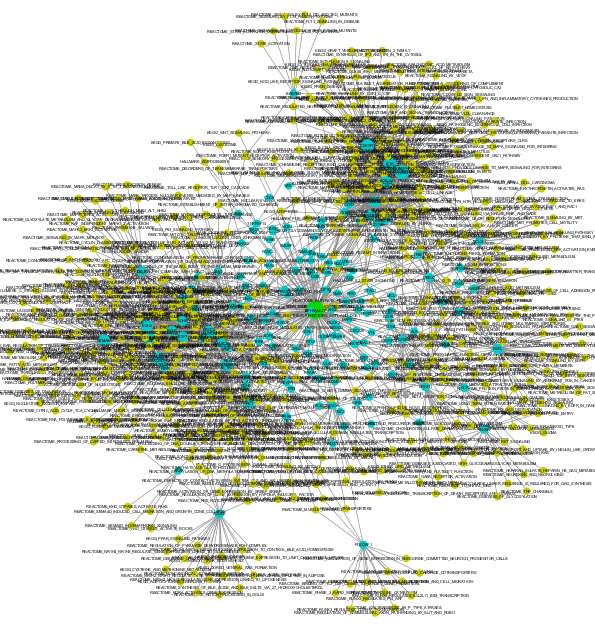

In [198]:
p4c = av.display_cynetwork2(all_enrichment_df,all_enrichment_types_df,
                           colors=['#04DB00','#00CCCC','#CCCC00'],layout='force-directed')
#p4c = av.display_cynetwork2(tmp_df,all_enrichment_types_df,
#                           colors=['#04DB00','#00CCCC','#CCCC00'],layout='force-directed')

os.chdir(fig_folder)
file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_pathway_network.png")
p4c.export_image(file,resolution=600);
p4c.notebook_show_image(file)

In [201]:
#Save network to file
p4c.export_network(net_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_pathway_network.sif"),type='SIF',overwrite_file=True);

#### Enrichment heatmap

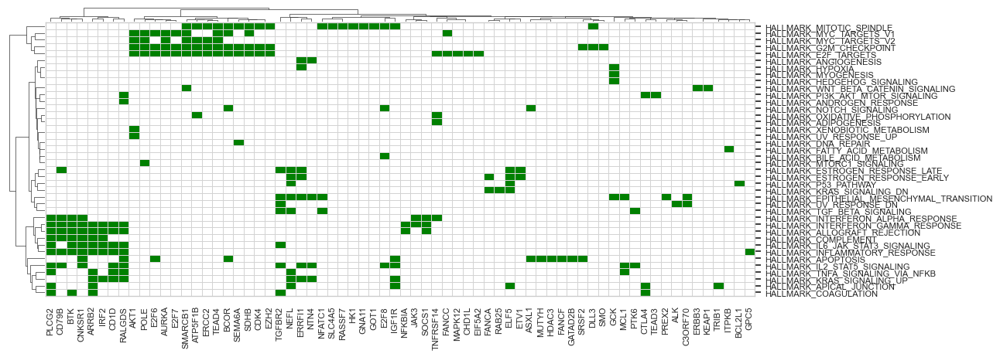

In [205]:
subset = "HALLMARK"
g=av.enrichment_heatmap(subset,all_enrichment_df,driver_gene,fig_folder)
g.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+subset+"_Enrichment_heatmap.pdf"),dpi=600,format='pdf')

#### Build network for neoPPI signatutre genes and pathways

##### Cytoscape network
<span style="color:green"> Have the Cytoscape application open before you execute the next cell </span><br>
https://cytoscape.org/

,SET,fpval,num_sig_genes,num_sig_genes_included,num_genes_in_pathway,"Expected, %","Actual, %",Enrichment,sig_genes_included,fqval
80,REACTOME_CELL_CYCLE,0.000000,62,21,693,3.522236,33.870968,9.616325,GTSE1; PKMYT1; CDK4; RMI2; CDT1; CENPH; AURKB; PLK1; CENPA; FOXM1; MCM5; RHNO1; CDC45; NUP37; POLE; TK1; TPX2; MCM2; TUBA1B; CENPM; MYBL2,0.000000
245,REACTOME_CELL_CYCLE_MITOTIC,0.000000,62,19,561,2.851334,30.645161,10.747657,GTSE1; PKMYT1; CDK4; CDT1; CENPH; AURKB; PLK1; CENPA; FOXM1; MCM5; CDC45; NUP37; POLE; TK1; TPX2; MCM2; TUBA1B; CENPM; MYBL2,0.000000
8,HALLMARK_E2F_TARGETS,0.000000,62,13,200,1.016518,20.967742,20.627016,PHF5A; CDK4; AURKB; PLK1; MCM5; KIF18B; POLE; TK1; MCM2; XRCC6; RANBP1; CENPM; MYBL2,0.000000
1,HALLMARK_G2M_CHECKPOINT,0.000000,62,11,200,1.016518,17.741935,17.453629,CDK4; AURKB; PLK1; CENPA; MCM5; TROAP; CDC45; POLE; TPX2; MCM2; MYBL2,0.000000
251,REACTOME_CELL_CYCLE_CHECKPOINTS,0.000000,62,13,291,1.479034,20.967742,14.176643,GTSE1; PKMYT1; RMI2; CENPH; AURKB; PLK1; CENPA; MCM5; RHNO1; CDC45; NUP37; MCM2; CENPM,0.000000
9,HALLMARK_MYC_TARGETS_V1,0.000000,62,9,200,1.016518,14.516129,14.280242,CDK4; SF3B3; EIF4A1; MCM5; CDC45; SNRPD3; MCM2; XRCC6; RANBP1,0.000000
166,REACTOME_MITOTIC_G1_PHASE_AND_G1_S_TRANSITION,0.000000,62,8,149,0.757306,12.903226,17.038320,CDK4; CDT1; MCM5; CDC45; POLE; TK1; MCM2; MYBL2,0.000002
236,REACTOME_ACTIVATION_OF_THE_PRE_REPLICATIVE_COMPLEX,0.000000,62,5,33,0.167726,8.064516,48.081623,CDT1; MCM5; CDC45; POLE; MCM2,0.000004
123,REACTOME_RESOLUTION_OF_SISTER_CHROMATID_COHESION,0.000000,62,7,126,0.640407,11.290323,17.629928,CENPH; AURKB; PLK1; CENPA; NUP37; TUBA1B; CENPM,0.000007
68,REACTOME_POLO_LIKE_KINASE_MEDIATED_EVENTS,0.000000,62,4,16,0.081321,6.451613,79.334677,PKMYT1; PLK1; FOXM1; MYBL2,0.000007


Applying default style...
Applying preferred layout
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.
style_name not specified, so updating "default" style.


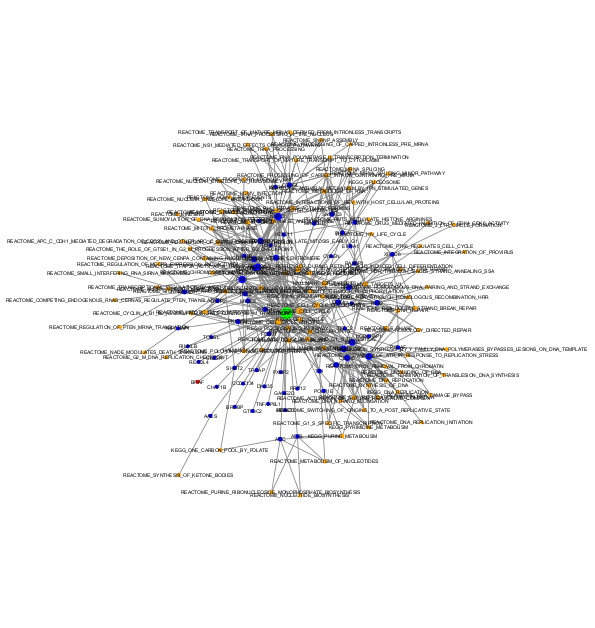

In [206]:
partner = "AURKA"
#sig_genes = set(sign_gene_dict[partner].index.tolist())
enrichment_df = enrichment_dict[partner]
display(HTML("<div style='height: 400px; overflow: auto;width: fit-content'>" +
             enrichment_df.loc[enrichment_df['fqval']<0.1].sort_values(by=['fqval']).style.to_html() + 
             "</div>"))
os.chdir(fig_folder)
p4c = av.display_cynetwork(driver_gene,partner,cancer,sig_genes,enrichment_df,0.1,
                      colors=['#FF0000','#00FF00','#0000FF','#FFA500'],layout='force-directed')
file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_signature_genes_pathway_network.png")
p4c.export_image(filename=file,resolution=600,overwrite_file=True);
p4c.notebook_show_image(file)

In [207]:
#Save network to file
p4c.export_network(net_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_signature_genes_pathway_network.sif"),
                   type='SIF',overwrite_file=True);

##### Interactive network

In [317]:
ipycytoscape_obj, pdf, net_dict = av.create_interactive_network(driver_gene, partner,enrichment_df,
                                                                0.05,['green','red','blue','orange'],
                                                               sig_genes,net_folder)
ipycytoscape_obj

CytoscapeWidget(cytoscape_layout={'name': 'breadthfirst', 'roots': ['BRAF'], 'animate': True}, cytoscape_style…

#### Generate text description for predicted neoPPI functions

In [209]:
description = av.get_txt_description_of_regulations(driver_gene,driver_mut,partner,pdf,net_dict)

BRAF p.V600E/AURKA interaction can regulate HALLMARK_G2M_CHECKPOINT by upregulating CDK4,AURKB,PLK1,CENPA,MCM5,TROAP,CDC45,POLE,TPX2,MCM2,MYBL2
BRAF p.V600E/AURKA interaction can regulate HALLMARK_E2F_TARGETS by upregulating PHF5A,CDK4,AURKB,PLK1,MCM5,KIF18B,POLE,TK1,MCM2,XRCC6,RANBP1,CENPM,MYBL2
BRAF p.V600E/AURKA interaction can regulate HALLMARK_MYC_TARGETS_V1 by upregulating CDK4,SF3B3,EIF4A1,MCM5,CDC45,SNRPD3,MCM2,XRCC6,RANBP1
BRAF p.V600E/AURKA interaction can regulate HALLMARK_MYC_TARGETS_V2 by upregulating CDK4,PLK1,MCM5,RRP12
BRAF p.V600E/AURKA interaction can regulate KEGG_PURINE_METABOLISM by upregulating POLR1E,ATIC,POLE,ADSL
BRAF p.V600E/AURKA interaction can regulate KEGG_PYRIMIDINE_METABOLISM by upregulating POLR1E,POLE,TK1
BRAF p.V600E/AURKA interaction can regulate KEGG_ONE_CARBON_POOL_BY_FOLATE by upregulating SHMT2,ATIC
BRAF p.V600E/AURKA interaction can regulate KEGG_DNA_REPLICATION by upregulating MCM5,POLE,MCM2
BRAF p.V600E/AURKA interaction can regulate KEGG_SPLI

In [213]:
#Save it!
fname = tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_neoPPI_functions.txt")
with open(fname, 'w') as f:
    f.write(description)

### Determine neoPPI signature genes which contribute in worsened clinical outcomes in the mutated samples

In [ ]:
survival_pplots = {}
for partner in partners:
    sign_gene_dict,figs = av.get_sig_gene_survival_plot(partner,df_mut_exp_samples,sign_gene_dict,clinical_f)
    survival_plots[partner] = figs

In [304]:
sign_gene_dict['AURKA'].head()

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL,CANCER,DRIVER,PARTNER,med_time_high,med_time_low,CLIN_PVAL
GENE,,,,,,,,,,,,,,,,
AACS,0.379498,190,0.153115,214,6.668644e-08,6.900597e-07,2.509199e-02,5.728432e-02,0.007326,0.198023,SKCM,BRAF_p.V600E,AURKA,4.493150,9.257534,0.028632
ADSL,0.469645,193,0.277890,213,5.576593e-12,1.308536e-10,3.903696e-05,1.615645e-04,0.012565,0.218930,SKCM,BRAF_p.V600E,AURKA,8.753424,9.380821,0.940723
ATIC,0.393448,193,0.207604,214,1.510120e-08,1.786601e-07,2.269280e-03,6.888711e-03,0.020094,0.239785,SKCM,BRAF_p.V600E,AURKA,9.460273,13.506848,0.731310
AURKB,0.523905,195,0.350153,215,3.859257e-15,1.712464e-13,1.348130e-07,7.713108e-07,0.015041,0.225983,SKCM,BRAF_p.V600E,AURKA,5.087671,9.460273,0.003390
BRI3BP,0.441849,196,0.260588,211,8.987506e-11,1.653665e-09,1.285933e-04,4.910464e-04,0.018808,0.237112,SKCM,BRAF_p.V600E,AURKA,4.241096,9.460273,0.002047


In [306]:
out_df =pd.DataFrame()
for partner in sign_gene_dict.keys():
    pdf = sign_gene_dict[partner]
    if len(pdf)>0:
        if len(out_df)==0:
            out_df = pdf.copy()
        else:
            out_df = pd.concat([out_df,pdf])
out_df.head()

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL,CANCER,DRIVER,PARTNER,med_time_high,med_time_low,CLIN_PVAL
GENE,,,,,,,,,,,,,,,,
ARHGAP19,0.452421,192,0.291157,214,4.459717e-11,1.344590e-09,0.000015,0.000061,0.030310,0.172597,SKCM,BRAF_p.V600E,ACVR1B,8.199999,8.753424,0.512850
PRRC2B,0.426341,194,0.282154,210,5.709857e-10,1.345339e-08,0.000033,0.000128,0.049628,0.206535,SKCM,BRAF_p.V600E,ACVR1B,9.380821,8.753424,0.847202
R3HCC1L,0.425368,190,0.246129,212,9.494737e-10,2.117373e-08,0.000297,0.000959,0.021894,0.150627,SKCM,BRAF_p.V600E,ACVR1B,8.605479,11.567122,0.942711
ARPIN,0.395460,192,0.193169,216,1.370800e-08,2.206158e-07,0.004380,0.010999,0.012945,0.121741,SKCM,BRAF_p.V600E,ACVR1B,11.567122,8.753424,0.705863
CAD,0.341473,191,0.135908,212,1.335648e-06,1.315624e-05,0.048117,0.089610,0.014675,0.128598,SKCM,BRAF_p.V600E,ACVR1B,8.199999,8.605479,0.723798


In [307]:
out_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                                               "_signature_genes_clin.csv"),sep=",")

In [313]:
#Save survival plots with p-value < 0.05
for partner in survival_plots.keys():
    figs = survival_plots[partner]
    for gene in figs.keys():
        file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_"+gene+"_survival_plot.png")
        fig,p_value,med_time_high,med_time_low =  figs[gene]
        if p_value < 0.05 and med_time_high < med_time_low:
            fig.savefig(file,dpi=600,format='png')

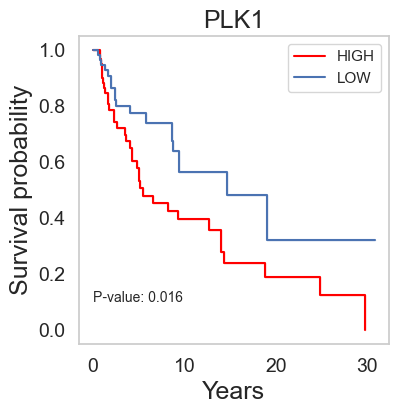

In [319]:
#Survival plot for a single gene
gene = 'PLK1'
out = av.single_gene_survival_plot(df_mut_exp_samples,gene,clinical_f)
out[0]

In [620]:
#Save it
out[0].savefig(fig_folder+'survival_'+gene+'.pdf',dpi=600,format='pdf')

### Identify available drugs for neoPPI-regulated genes

In [321]:
sign_gene_dict['AURKA'].head()

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL,CANCER,DRIVER,PARTNER,med_time_high,med_time_low,CLIN_PVAL
GENE,,,,,,,,,,,,,,,,
AACS,0.379498,190,0.153115,214,6.668644e-08,6.900597e-07,2.509199e-02,5.728432e-02,0.007326,0.198023,SKCM,BRAF_p.V600E,AURKA,4.493150,9.257534,0.028632
ADSL,0.469645,193,0.277890,213,5.576593e-12,1.308536e-10,3.903696e-05,1.615645e-04,0.012565,0.218930,SKCM,BRAF_p.V600E,AURKA,8.753424,9.380821,0.940723
ATIC,0.393448,193,0.207604,214,1.510120e-08,1.786601e-07,2.269280e-03,6.888711e-03,0.020094,0.239785,SKCM,BRAF_p.V600E,AURKA,9.460273,13.506848,0.731310
AURKB,0.523905,195,0.350153,215,3.859257e-15,1.712464e-13,1.348130e-07,7.713108e-07,0.015041,0.225983,SKCM,BRAF_p.V600E,AURKA,5.087671,9.460273,0.003390
BRI3BP,0.441849,196,0.260588,211,8.987506e-11,1.653665e-09,1.285933e-04,4.910464e-04,0.018808,0.237112,SKCM,BRAF_p.V600E,AURKA,4.241096,9.460273,0.002047


In [333]:
clin_genes = []
for partner in partners:
    tmp = sign_gene_dict[partner].loc[sign_gene_dict[partner]['CLIN_PVAL']<0.05]
    tmp = tmp.loc[tmp['med_time_high']<tmp['med_time_low']]
    tmp = tmp.index.values.tolist()
    clin_genes = clin_genes+tmp
clin_genes = list(set(clin_genes))
print("There are a total of:",len(clin_genes),"clinical genes")

There are a total of: 317 clinical genes


In [334]:
ligands_df=av.get_ligand_information_in_clinical(clin_genes)

IntProgress(value=0, max=317)

In [337]:
ligands_df = ligands_df.loc[ligands_df['num_total_ligands'] !=0]
out = []
for i in ligands_df.index:
    if ligands_df.loc[i]['approved_drugs']!="":
        app_drugs = ligands_df.loc[i]['approved_drugs']
        app_drugs = app_drugs.replace("PMID:","PMID").split(":")
    if ligands_df.loc[i]['all_ligands']!="":
        all_ligs = ligands_df.loc[i]['all_ligands']
        all_ligs = all_ligs.replace("PMID:","PMID").split(":")
        all_ligs=[x for x in all_ligs if x not in app_drugs]
        for lig in all_ligs:
            out.append([i,lig,'not_approved'])
        for lig in app_drugs:
            out.append([i,lig,'approved'])
drugs_df = pd.DataFrame(out,columns=['gene','compound','status'])
drugs_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_genes_with_drugs.csv"),sep=",")
drugs_df.head()


,gene,compound,status
0,RRM2,clofarabine,approved
1,RRM2,fludarabine,approved
2,RRM2,gemcitabine,approved
3,RRM2,hydroxyurea,approved
4,PADI1,<i>o</i>-F-amidine,not_approved


In [ ]:
print("done")